<a href="https://colab.research.google.com/github/saiyuu330/COSE474_Project/blob/main/DL_projecr02.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Total frames: 127


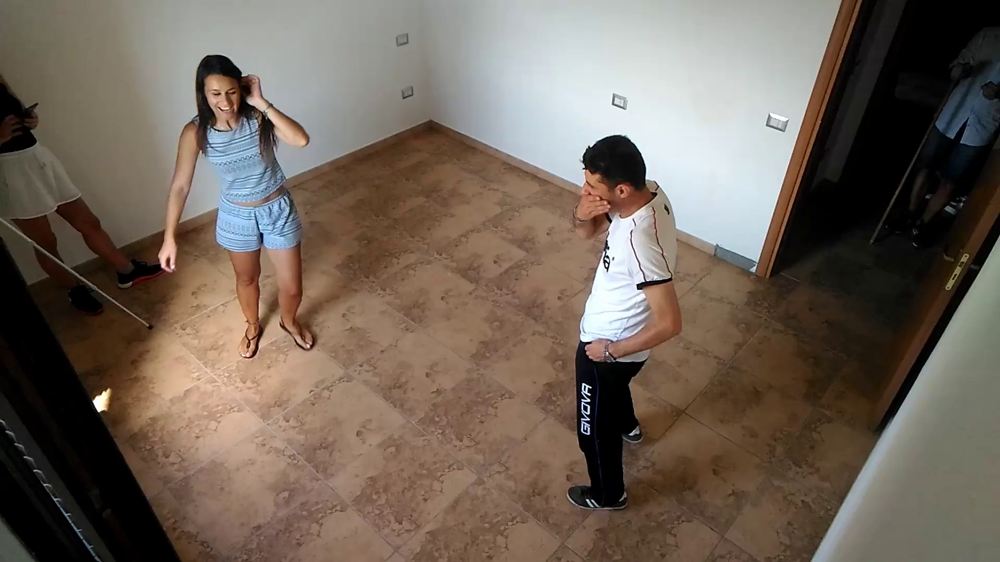

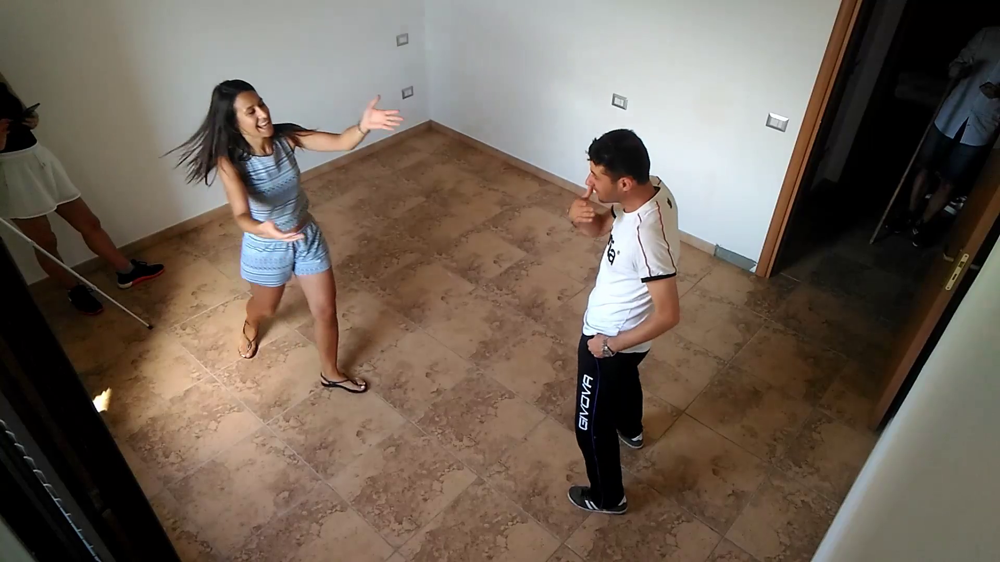

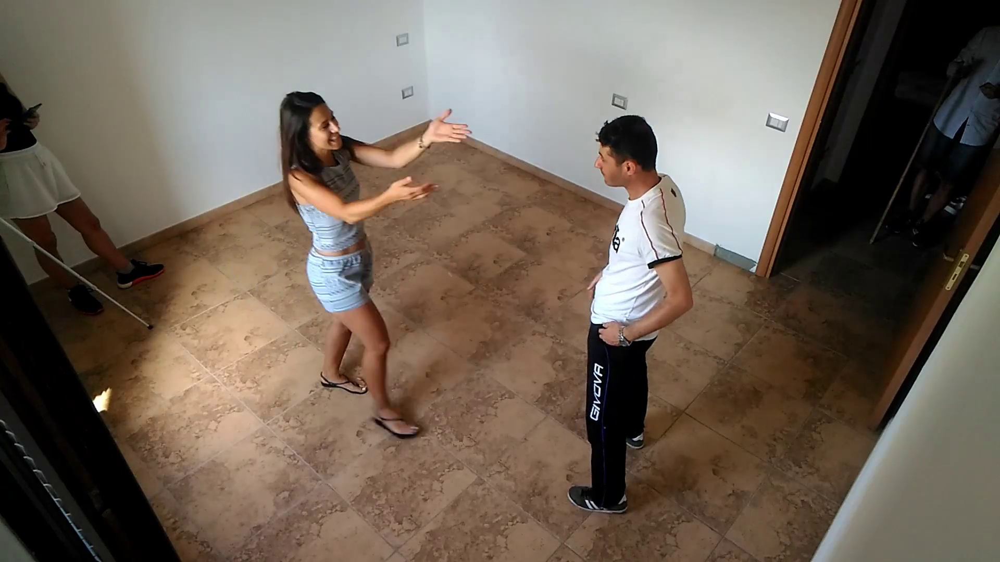

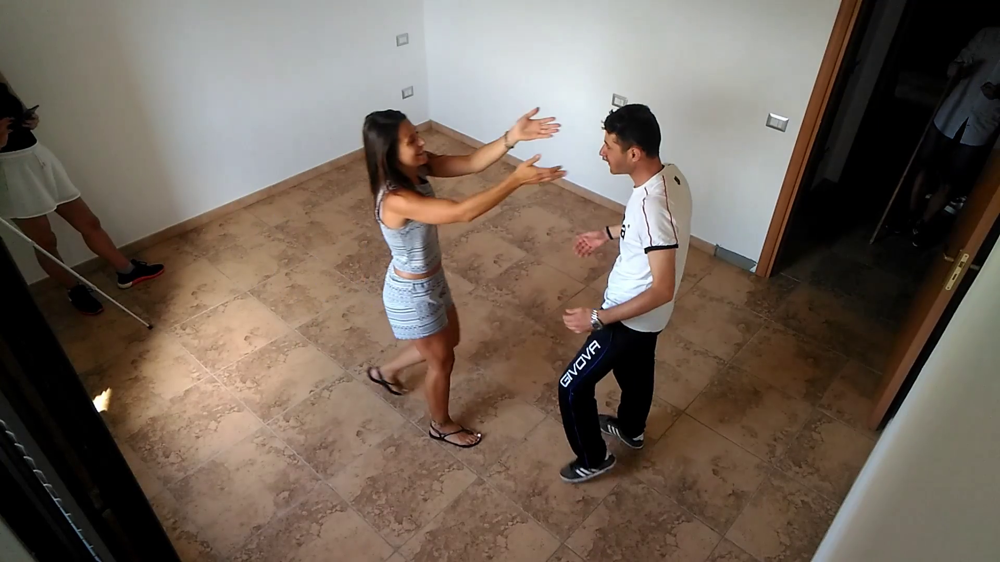

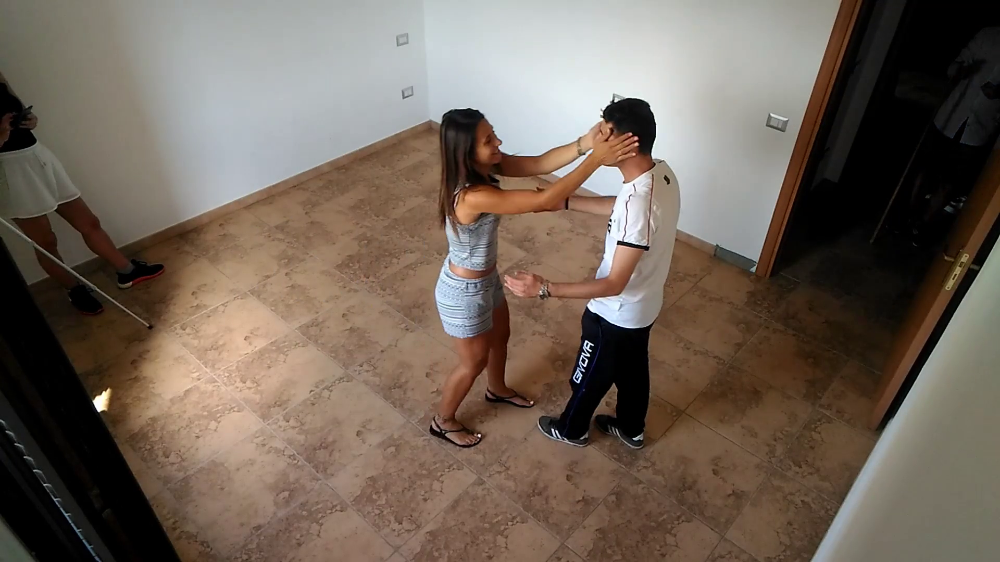

...

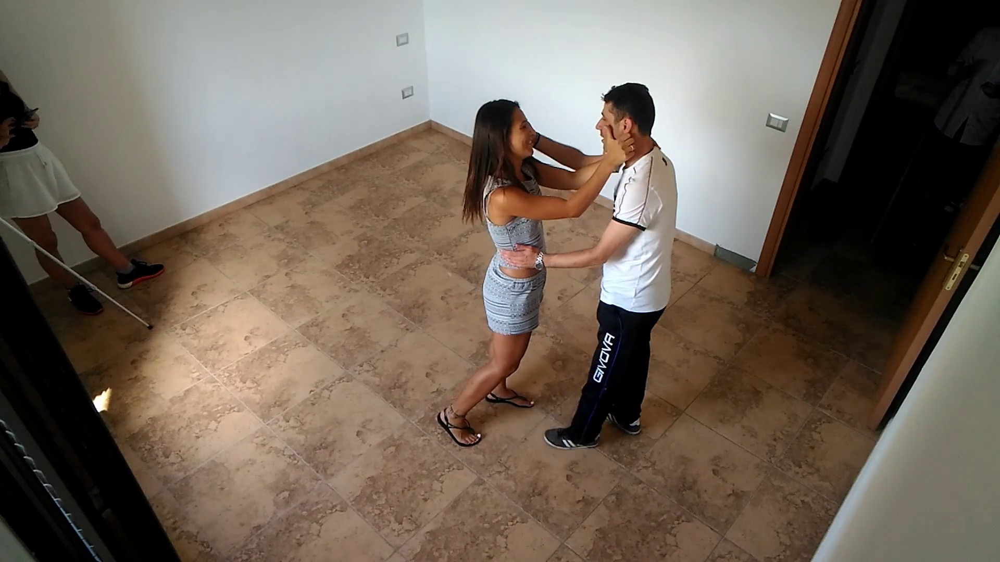

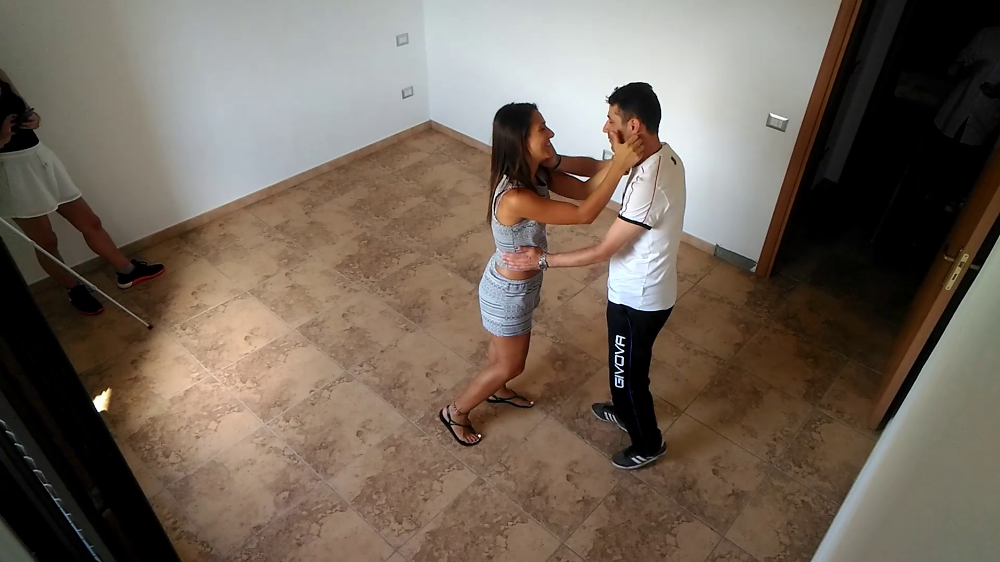

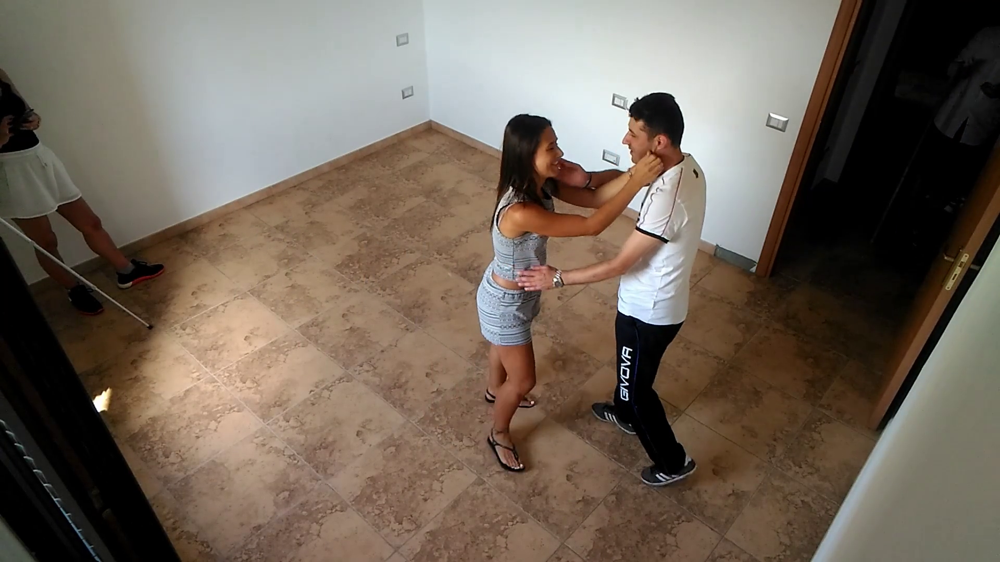

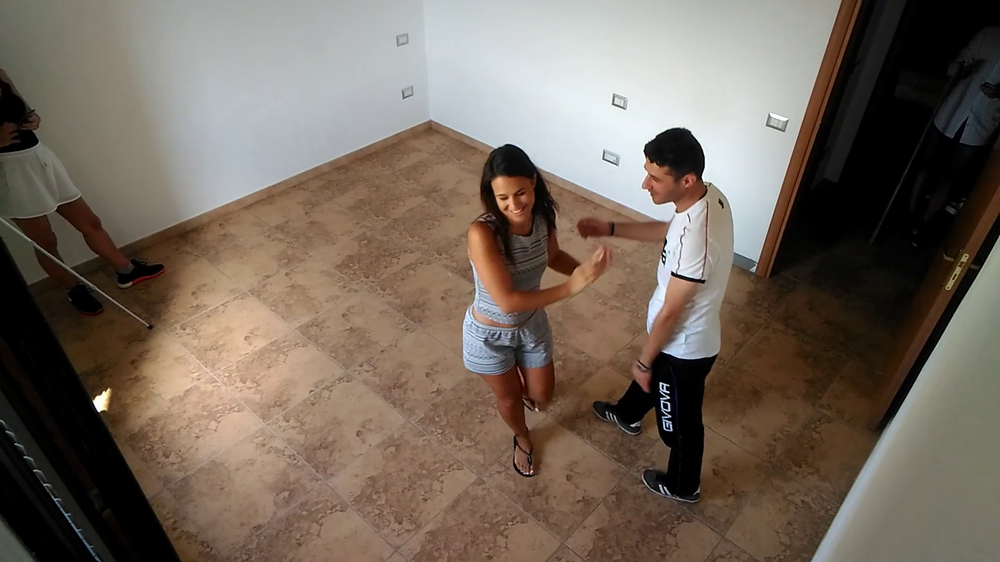

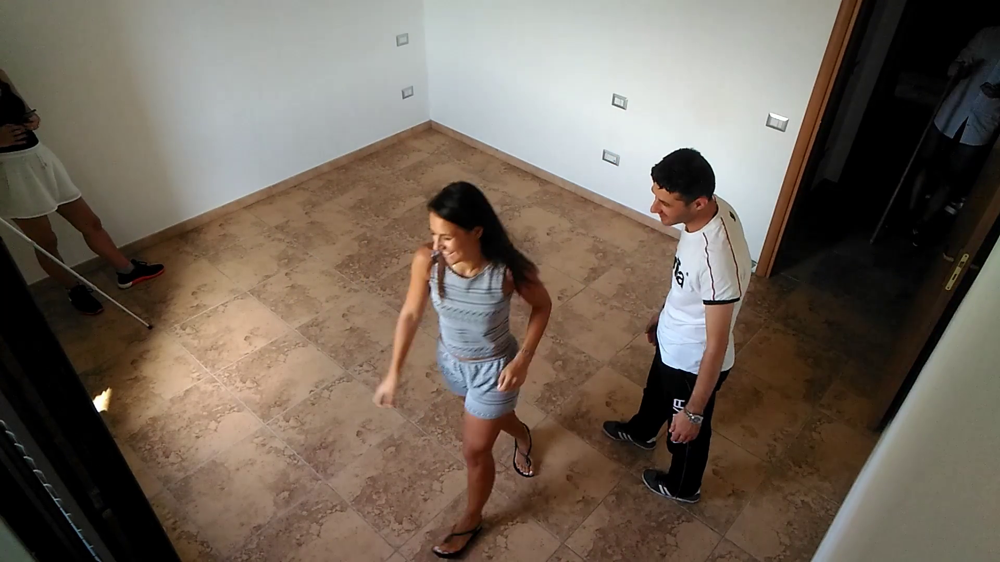

In [ ]:
import cv2
import os
from google.colab.patches import cv2_imshow

# 영상 파일 경로
video_path = '/content/drive/MyDrive/Colab Notebooks/8.mp4'

# 영상 읽기
cap = cv2.VideoCapture(video_path)

# 프레임 수 확인
num_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print(f'Total frames: {num_frames}')

# 저장할 디렉토리 생성
output_dir = 'frames'
os.makedirs(output_dir, exist_ok=True)

# 각 프레임을 분리하고 시각화
for frame_number in range(num_frames):
    # 프레임 읽기
    ret, frame = cap.read()

    # 프레임이 읽어지지 않으면 종료
    if not ret:
        break

    # 프레임 파일로 저장 (옵션)
    frame_filename = os.path.join(output_dir, f'frame_{frame_number:04d}.jpg')
    cv2.imwrite(frame_filename, frame)

    # 프레임 시각화
    if(frame_number % 10 == 0):
      cv2_imshow(frame)

    # 'q' 키를 누르면 종료
    if cv2.waitKey(25) & 0xFF == ord('q'):
        break

# 종료
cap.release()
cv2.destroyAllWindows()


In [ ]:
%cd /content/drive/MyDrive/Colab Notebooks
output_dir = 'frames'
os.makedirs(output_dir, exist_ok=True)

# 10번째 프레임마다 저장할 리스트 초기화
frames_to_save = []

# 각 프레임을 분리하고 10번째 프레임마다 모아 저장
for frame_number in range(num_frames):
    # 프레임 읽기
    ret, frame = cap.read()

    # 프레임이 읽어지지 않으면 종료
    if not ret:
        break

    # 10번째 프레임마다 리스트에 추가
    if frame_number == 0 or frame_number % 10 == 0:
        frames_to_save.append(frame)
print(len(frames_to_save))
# frames_to_save가 비어 있는지 확인
if not frames_to_save:
    print("No frames to save.")
else:
    # 새로운 동영상 파일명
    output_video_path = '/content/drive/MyDrive/Colab Notebooks/output_video.avi'

    # 동영상 생성기 초기화
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    out = cv2.VideoWriter(output_video_path, fourcc, 30.0, (frames_to_save[0].shape[1], frames_to_save[0].shape[0]))

    # 프레임 저장
    for frame_to_save in frames_to_save:
        out.write(frame_to_save)

    # 종료
    out.release()

# 종료
cap.release()
cv2.destroyAllWindows()

/content/drive/MyDrive/Colab Notebooks
0
No frames to save.
